## Import scGPT and dependencies

In [1]:
from pathlib import Path
import warnings

import scanpy as sc
import scib
import numpy as np
import sys

sys.path.insert(0, "../")

import scgpt as scg
import matplotlib.pyplot as plt
import anndata

plt.style.context('default')
warnings.simplefilter("ignore", ResourceWarning)

model_dir = Path("/home/themandalorian/ETH/PMLR2025/scGPT/save/scGPT_pancancer")

/home/themandalorian/ETH/PMLR2025/scGPT/pmlr25/../scgpt/model/model.py:21: UserWarning: flash_attn is not installed
  warnings.warn("flash_attn is not installed")
/home/themandalorian/ETH/PMLR2025/scGPT/pmlr25/../scgpt/model/multiomic_model.py:19: UserWarning: flash_attn is not installed
  warnings.warn("flash_attn is not installed")
/home/themandalorian/anaconda3/envs/scGPT/lib/python3.9/site-packages/torchtext/vocab/__init__.py:4: UserWarning: 
/!\ IMPORTANT WARNING ABOUT TORCHTEXT STATUS /!\ 
Torchtext is deprecated and the last released version will be 0.18 (this one). You can silence this warning by calling the following at the beginnign of your scripts: `import torchtext; torchtext.disable_torchtext_deprecation_warning()`
  warnings.warn(torchtext._TORCHTEXT_DEPRECATION_MSG)
/home/themandalorian/anaconda3/envs/scGPT/lib/python3.9/site-packages/torchtext/utils.py:4: UserWarning: 
/!\ IMPORTANT WARNING ABOUT TORCHTEXT STATUS /!\ 
Torchtext is deprecated and the last released versio

In [2]:
"""
Calculate the metrics for integration results
"""
def scib_eval(adata, batch_key, cell_type_key, embed_key):
    results = scib.metrics.metrics(
        adata,
        adata_int=adata,
        batch_key=batch_key,
        label_key=cell_type_key,
        embed=embed_key,
        isolated_labels_asw_=False,
        silhouette_=True,
        hvg_score_=False,
        graph_conn_=True,
        pcr_=True,
        isolated_labels_f1_=False,
        trajectory_=False,
        nmi_=True,  # use the clustering, bias to the best matching
        ari_=True,  # use the clustering, bias to the best matching
        cell_cycle_=False,
        kBET_=False,  # kBET return nan sometimes, need to examine
        ilisi_=False,
        clisi_=False,
    )
    result_dict = results[0].to_dict()
    
    # compute avgBIO metrics
    result_dict["avg_bio"] = np.mean(
        [
            result_dict["NMI_cluster/label"],
            result_dict["ARI_cluster/label"],
            result_dict["ASW_label"],
        ]
    )
    
    # compute avgBATCH metrics
    result_dict["avg_batch"] = np.mean(
        [
            result_dict["graph_conn"],
            result_dict["ASW_label/batch"],
        ]
    )
    
    result_dict = {k: v for k, v in result_dict.items() if not np.isnan(v)}
    
    return result_dict

In [3]:
sample_data_path = '/home/themandalorian/ETH/PMLR2025/scGPT/data/NB.bone.Met_preprocessed.h5ad'
adata = sc.read_h5ad(sample_data_path)

In [4]:
print(adata)

AnnData object with n_obs × n_vars = 36763 × 25139
    obs: 'cell1', 'cell2', 'fraction', 'sample', 'cell_ID', 'n_genes', 'leiden'
    var: 'hgnc_symbol', 'ensembl_gene_id', 'gene_biotype', 'n_cells', 'mean', 'std'
    uns: 'leiden', 'neighbors', 'pca', 'umap'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    layers: 'RNA', 'log1p_norm'
    obsp: 'connectivities', 'distances'


In [5]:
N_HVG = len(adata.obs["n_genes"].value_counts())
gene_col = "hgnc_symbol"
cell_type_key = "cell1"
batch_key = "sample"

In [6]:
#Remove Unannoted Cells
celltype_id_labels = adata.obs[cell_type_key].astype("category").cat.codes.values
adata = adata[celltype_id_labels >= 0]

print(adata)

#Make a Copy of Dataset
#org_adata = adata.copy()

View of AnnData object with n_obs × n_vars = 36763 × 25139
    obs: 'cell1', 'cell2', 'fraction', 'sample', 'cell_ID', 'n_genes', 'leiden'
    var: 'hgnc_symbol', 'ensembl_gene_id', 'gene_biotype', 'n_cells', 'mean', 'std'
    uns: 'leiden', 'neighbors', 'pca', 'umap'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    layers: 'RNA', 'log1p_norm'
    obsp: 'connectivities', 'distances'


In [7]:
# highly variable genes
sc.pp.highly_variable_genes(adata, n_top_genes=N_HVG, flavor='cell_ranger')
adata = adata[:, adata.var['highly_variable']]

/home/themandalorian/anaconda3/envs/scGPT/lib/python3.9/site-packages/scanpy/preprocessing/_highly_variable_genes.py:696: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns["hvg"] = {"flavor": flavor}


In [8]:
embed_adata = scg.tasks.embed_data(
    adata,
    model_dir,
    gene_col=gene_col,
    batch_size=64,
)
# attach the cell embedding to the original adata

/home/themandalorian/ETH/PMLR2025/scGPT/pmlr25/../scgpt/tasks/cell_emb.py:212: ImplicitModificationWarning: Trying to modify attribute `.var` of view, initializing view as actual.
  adata.var["id_in_vocab"] = [


scGPT - INFO - match 3245/4402 genes in vocabulary of size 60697.


/home/themandalorian/ETH/PMLR2025/scGPT/pmlr25/../scgpt/model/model.py:77: UserWarning: flash-attn is not installed, using pytorch transformer instead. Set use_fast_transformer=False to avoid this warning. Installing flash-attn is highly recommended.
  warnings.warn(
Embedding cells:   0%|                                                                                                               | 0/575 [00:00<?, ?it/s]/home/themandalorian/anaconda3/envs/scGPT/lib/python3.9/site-packages/einops/_torch_specific.py:109: ImportWarning: allow_ops_in_compiled_graph failed to import torch: ensure pytorch >=2.0
  warnings.warn("allow_ops_in_compiled_graph failed to import torch: ensure pytorch >=2.0", ImportWarning)
/home/themandalorian/anaconda3/envs/scGPT/lib/python3.9/site-packages/einops/_torch_specific.py:109: ImportWarning: allow_ops_in_compiled_graph failed to import torch: ensure pytorch >=2.0
  warnings.warn("allow_ops_in_compiled_graph failed to import torch: ensure pytorch >=2.0"

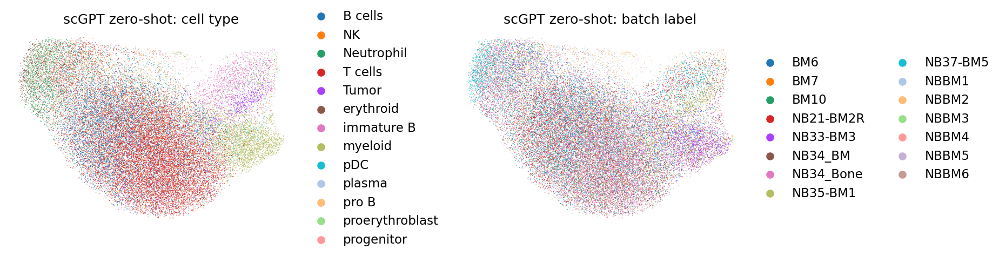

In [9]:
sc.pp.neighbors(embed_adata, use_rep="X_scGPT")
sc.tl.umap(embed_adata)
sc.pl.umap(embed_adata, 
           color=[cell_type_key, batch_key], 
           frameon=False, 
           wspace=0.4, 
           title=["scGPT zero-shot: cell type", "scGPT zero-shot: batch label"])

In [18]:
import umap

# Use the same input that sc.pp.neighbors used
X_input = embed_adata.obsm['X_scGPT']

# Run 3D UMAP
umap_3d = umap.UMAP(n_components=3, random_state=42)
embed_adata.obsm['X_umap_3d'] = umap_3d.fit_transform(X_input)

/home/themandalorian/anaconda3/envs/scGPT/lib/python3.9/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/home/themandalorian/anaconda3/envs/scGPT/lib/python3.9/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


In [19]:
import plotly.express as px
import pandas as pd

# Use your favorite cluster label
cluster_label = 'leiden'  # or 'cluster_1.0', 'sample', etc.

# Build DataFrame for Plotly
umap_df = pd.DataFrame(embed_adata.obsm['X_umap_3d'], columns=['UMAP1', 'UMAP2', 'UMAP3'])
umap_df[cluster_label] = embed_adata.obs[cluster_label].values

# Create interactive 3D plot
fig = px.scatter_3d(
    umap_df,
    x='UMAP1', y='UMAP2', z='UMAP3',
    color=cluster_label,
    title='Interactive 3D UMAP',
    opacity=0.8,
    height=700,
    width=1000
)

fig.update_traces(marker=dict(size=2))
fig.update_layout(scene_camera=dict(eye=dict(x=1.2, y=1.2, z=1.2)))
fig.show()

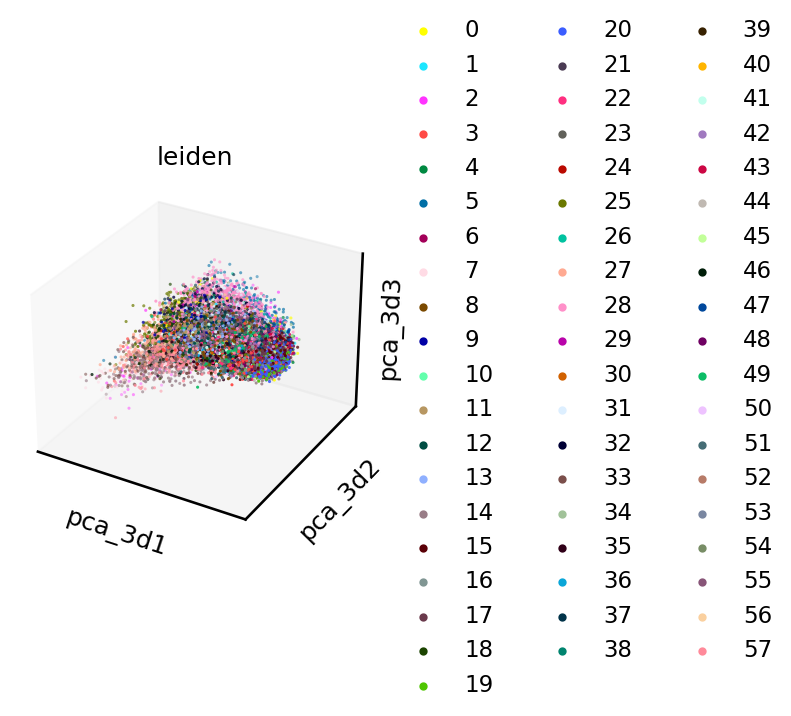

In [20]:
from sklearn.decomposition import PCA

# Project existing X_scGPT or raw gene matrix to 3D PCA
# Choose the embedding you want to reduce
X_input = embed_adata.obsm['X_scGPT']  # or use 'X_pca' if already PCA'ed

# Run PCA with 3 components
pca_3d = PCA(n_components=3)
embed_adata.obsm['X_pca_3d'] = pca_3d.fit_transform(X_input)

# Visualize using scanpy 3D plot with cluster coloring (e.g. leiden)
sc.pl.embedding(embed_adata, basis='pca_3d', color='leiden', projection='3d')

# Get PCA 3D (or any other 3D embedding)
coords = embed_adata.obsm['X_pca_3d']  # or 'X_umap_3d' if you've run UMAP in 3D

# Choose a cluster label (e.g., 'leiden', 'cluster_1.0', 'sample', etc.)
cluster_label = 'leiden'

# Build dataframe for Plotly
plot_df = pd.DataFrame(coords, columns=['PC1', 'PC2', 'PC3'])
plot_df[cluster_label] = embed_adata.obs[cluster_label].values

# Interactive 3D plot
fig = px.scatter_3d(
    plot_df,
    x='PC1', y='PC2', z='PC3',
    color=cluster_label,
    title='3D PCA (interactive)',
    opacity=0.8,
    height=700,
    width=1000
)

fig.update_traces(marker=dict(size=2))
fig.update_layout(scene_camera=dict(eye=dict(x=1.3, y=1.3, z=1.3)))  # default 3D camera angle
fig.show()

In [21]:
scib_result_dict = scib_eval(
    embed_adata,
    batch_key=batch_key,
    cell_type_key=cell_type_key,
    embed_key="X_scGPT",
)

Cluster for cluster_0.2 with leiden


/home/themandalorian/anaconda3/envs/scGPT/lib/python3.9/site-packages/scib/metrics/clustering.py:96: FutureWarning:

In the future, the default backend for leiden will be igraph instead of leidenalg.

 To achieve the future defaults please pass: flavor="igraph" and n_iterations=2.  directed must also be False to work with igraph's implementation.



Cluster for cluster_0.4 with leiden
Cluster for cluster_0.6 with leiden
Cluster for cluster_0.8 with leiden
Cluster for cluster_1.0 with leiden
Cluster for cluster_1.2 with leiden
Cluster for cluster_1.4 with leiden
Cluster for cluster_1.6 with leiden
Cluster for cluster_1.8 with leiden
Cluster for cluster_2.0 with leiden
NMI...
ARI...
Silhouette score...
PC regression...


/home/themandalorian/anaconda3/envs/scGPT/lib/python3.9/site-packages/scanpy/preprocessing/_pca.py:377: FutureWarning:

Argument `use_highly_variable` is deprecated, consider using the mask argument. Use_highly_variable=True can be called through mask_var="highly_variable". Use_highly_variable=False can be called through mask_var=None



Graph connectivity...


/home/themandalorian/anaconda3/envs/scGPT/lib/python3.9/site-packages/scib/metrics/graph_connectivity.py:56: FutureWarning:

pandas.value_counts is deprecated and will be removed in a future version. Use pd.Series(obj).value_counts() instead.

/home/themandalorian/anaconda3/envs/scGPT/lib/python3.9/site-packages/scib/metrics/graph_connectivity.py:56: FutureWarning:

pandas.value_counts is deprecated and will be removed in a future version. Use pd.Series(obj).value_counts() instead.

/home/themandalorian/anaconda3/envs/scGPT/lib/python3.9/site-packages/scib/metrics/graph_connectivity.py:56: FutureWarning:

pandas.value_counts is deprecated and will be removed in a future version. Use pd.Series(obj).value_counts() instead.

/home/themandalorian/anaconda3/envs/scGPT/lib/python3.9/site-packages/scib/metrics/graph_connectivity.py:56: FutureWarning:

pandas.value_counts is deprecated and will be removed in a future version. Use pd.Series(obj).value_counts() instead.

/home/themandalorian/ana

In [22]:
print("AvgBIO: {:.4f}".format(scib_result_dict["avg_bio"]))
print("AvgBATCH: {:.4f}".format(scib_result_dict["avg_batch"]))

AvgBIO: 0.2973
AvgBATCH: 0.8308


In [32]:
print(embed_adata)

AnnData object with n_obs × n_vars = 36763 × 3245
    obs: 'cell1', 'cell2', 'fraction', 'sample', 'cell_ID', 'n_genes', 'leiden', 'cluster_0.2', 'cluster_0.4', 'cluster_0.6', 'cluster_0.8', 'cluster_1.0', 'cluster_1.2', 'cluster_1.4', 'cluster_1.6', 'cluster_1.8', 'cluster_2.0', 'cluster', 'gmm_entropy'
    var: 'hgnc_symbol', 'ensembl_gene_id', 'gene_biotype', 'n_cells', 'mean', 'std', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'id_in_vocab'
    uns: 'leiden', 'neighbors', 'pca', 'umap', 'hvg', 'cell1_colors', 'sample_colors', 'leiden_colors', 'cluster_0.2', 'cluster_0.4', 'cluster_0.6', 'cluster_0.8', 'cluster_1.0', 'cluster_1.2', 'cluster_1.4', 'cluster_1.6', 'cluster_1.8', 'cluster_2.0'
    obsm: 'X_pca', 'X_umap', 'X_scGPT', 'X_umap_3d', 'X_pca_3d', 'X_gmm_probs'
    varm: 'PCs'
    layers: 'RNA', 'log1p_norm'
    obsp: 'connectivities', 'distances'


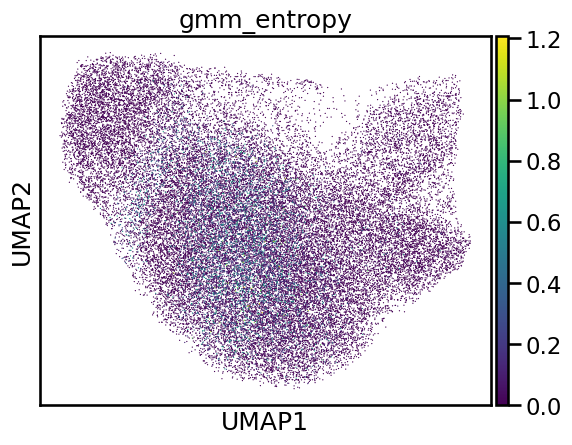

In [35]:
from sklearn.mixture import GaussianMixture
from scipy.stats import entropy

# Fit GMM
n_components = 20  # You can tweak this
gmm = GaussianMixture(n_components=n_components, random_state=42)
gmm.fit(embed_adata.obsm['X_scGPT'])

# Get membership probabilities
probs = gmm.predict_proba(embed_adata.obsm['X_scGPT'])

# Save the soft assignments
embed_adata.obsm['X_gmm_probs'] = probs

# Compute entropy of each row
cell_entropy = entropy(probs.T)  # Transpose so each column is a sample
embed_adata.obs['gmm_entropy'] = cell_entropy

# Optionally visualize entropy
sc.pl.embedding(embed_adata, basis='umap', color='gmm_entropy', cmap='viridis')

In [36]:
print(probs)
print(embed_adata.obs['gmm_entropy'])

[[4.21488939e-150 1.52645734e-267 1.38615963e-032 ... 1.96979746e-298
  8.95323221e-259 0.00000000e+000]
 [7.67232550e-253 1.74887557e-122 0.00000000e+000 ... 2.22716228e-082
  8.62150187e-294 0.00000000e+000]
 [3.86387751e-011 6.04201570e-049 1.17147040e-082 ... 2.30440035e-017
  8.15579537e-039 4.62412597e-062]
 ...
 [1.06911997e-005 3.27090380e-090 1.28088578e-013 ... 2.08194670e-048
  3.02269342e-086 2.52709385e-199]
 [4.21795009e-006 2.42689075e-076 5.01466252e-033 ... 6.57369079e-033
  3.54926738e-080 8.39423459e-113]
 [1.65531328e-003 5.90443324e-084 3.19344736e-013 ... 8.38295035e-037
  6.02958163e-081 1.62819862e-162]]
cell_ID
NBBM1_AAACGAAGTCCGGCAT-1        2.924359e-17
NBBM1_AAACGCTGTCACAATC-1        4.187316e-80
NBBM1_AAAGGATGTAGGCTGA-1        5.017203e-06
NBBM1_AAAGGTAGTCTCAGGC-1        1.416773e-04
NBBM1_AAAGGTAGTGAGTGAC-1        2.919454e-33
                                    ...     
NB34_Bone_TTTGTTGAGCGAAACC-1    2.169639e-03
NB34_Bone_TTTGTTGAGTCGCTAT-1    2.122239e

In [38]:
# Step 1: Run GMM on X_scGPT
X = embed_adata.obsm['X_scGPT']
n_components = 20
gmm = GaussianMixture(n_components=n_components, random_state=42)
gmm.fit(X)

# Step 2: Save hard + soft labels
embed_adata.obs['gmm_cluster'] = gmm.predict(X).astype(str)
embed_adata.obsm['X_gmm_probs'] = gmm.predict_proba(X)
embed_adata.obs['gmm_entropy'] = entropy(embed_adata.obsm['X_gmm_probs'].T)

# Step 3: Project to 3D for visualization
pca_3d = PCA(n_components=3)
embed_adata.obsm['X_pca_3d'] = pca_3d.fit_transform(X)

# Step 4: Build DataFrame with entropy
coords = embed_adata.obsm['X_pca_3d']
df = pd.DataFrame(coords, columns=['PC1', 'PC2', 'PC3'])
df['GMM Entropy'] = embed_adata.obs['gmm_entropy'].values

# Step 5: Plot with Plotly (colored by entropy)
fig = px.scatter_3d(
    df,
    x='PC1', y='PC2', z='PC3',
    color='GMM Entropy',
    color_continuous_scale='Viridis',
    title='3D PCA Projection Colored by GMM Entropy',
    opacity=0.9,
    height=700,
    width=1000
)

fig.update_traces(marker=dict(size=2))
fig.update_layout(scene_camera=dict(eye=dict(x=1.2, y=1.2, z=1.2)))
fig.show()